In [2]:
import torch
import IPython
import random
import cv2
import numpy as np
from PIL import Image
import json
import os
import subprocess as sp

### Setup
Boring stuff like reading the image. We use opencv to read the image, but PIL to print it. As they use different conventions for the RGB channels, we have to permute things to get the original image

In [3]:
## Setup
def read_image(fpath):
    image = cv2.imread(fpath)
    return np.swapaxes(np.array([image[:, :, 2], image[:, :, 1], image[:, :, 0]]).T, 0, 1)

def preview(image):
    return Image.fromarray(image)

def pfile(fpath):
    return preview(read_image(fpath))

## Corner Identification
Foo bar

In [4]:
def identify_corners(image):
    pass

## Mapping Corners to Grid Points


We want to apply a projective transformation from one coordinate space - the grid $\mathbb{Z}_n\times\mathbb{Z}_n$ to pixels in the image. This is a projective map defined by (for an arbitrary $\lambda$):

$$
M
\begin{bmatrix}
    X \\
    Y \\
    1 \\
\end{bmatrix}
=
\begin{bmatrix}
    a_0 & a_1 & a_2 \\
    b_0 & b_1 & b_2 \\
    c_0 & c_1 & 1 \\
\end{bmatrix}
\begin{bmatrix}
    X \\
    Y \\
    1 \\
\end{bmatrix}
=
\lambda
\begin{bmatrix}
    U \\
    V \\
    1 \\
\end{bmatrix}
$$

Note that $\lambda = c_0X + c_1Y + 1$.

We want to solve then for the $a_i$, $b_i$ and $c_i$. Notice that, as $\lambda$ is arbitrary, each pair of points solves for two degrees of freedom, so we need 4 pairs of points to solve this system. However, it's a bit non-trivial to get at. In order to solve it, note that each pair of points $(X, Y, 1)$ and $(U, V, 1)$ gives us a system of two equations:

$$
\begin{bmatrix}
    X & Y & 1 & 0 & 0 & 0 & -XU & -YU & -U \\
    0 & 0 & 0 & X & Y & 1 & -XV & -YV & -V \\
\end{bmatrix}
\begin{bmatrix}
    a_0 & a_1 & a_2 & b_0 & b_1 & b_2 & c_0 & c_1 & 1
\end{bmatrix}^T = 0
$$

Stacking the 8 systems of equations we get from our 4 pairs of points gives us a system, for some known matrix Z:

$$ Z \begin{bmatrix}
    a_0 & a_1 & a_2 & b_0 & b_1 & b_2 & c_0 & c_1 & 1
\end{bmatrix}^T = 0$$

Then, finding $M$ is equivalent to finding the right eigenvector of $Z$ that lies in its null space.

In [5]:
def _get_trans_matrix_1(corners, grid_size, c1, c2, c3, c4):
    n = grid_size - 1
    cols = [[0, 0, 0, 1],
            [n, 0, 0, 1],
            [0, n, 0, 1],
            [n, n, n * n, 1]]
    grid_matrix = np.array([cols[c1], cols[c2], cols[c3], cols[c4]]).T
    real_matrix = np.array([[*corners[c1], corners[c1][0] * corners[c1][1], 1],
                            [*corners[c2], corners[c2][0] * corners[c2][1], 1],
                            [*corners[c3], corners[c3][0] * corners[c3][1], 1],
                            [*corners[c4], corners[c4][0] * corners[c4][1], 1]]).T
    return real_matrix @ np.linalg.inv(grid_matrix)

def _get_trans_matrix(corners, grid_size, avg_corners=False):
    if avg_corners:
        M1 = _get_trans_matrix_1(corners, grid_size, 0, 1, 2)
        M2 = _get_trans_matrix_1(corners, grid_size, 0, 1, 3)
        M3 = _get_trans_matrix_1(corners, grid_size, 0, 2, 3)
        M4 = _get_trans_matrix_1(corners, grid_size, 1, 2, 3)
        return (M1 + M2 + M3 + M4) / 4
    return _get_trans_matrix_1(corners, grid_size, 0, 1, 2, 3)

def _get_trans_matrix(real_corners, grid_size):
    n = grid_size - 1
    grid_corners = [(0, 0), (n, 0), (0, n), (n, n)]
    rows = []
    for cidx in range(4):
        X = grid_corners[cidx][0]
        Y = grid_corners[cidx][1]
        U = real_corners[cidx][0]
        V = real_corners[cidx][1]
        rows.append([X, Y, 1, 0, 0, 0, -X * U, -Y * U, -U])
        rows.append([0, 0, 0, X, Y, 1, -X * V, -Y * V, -V])
    Z = np.array(rows)
    kern = np.linalg.svd(Z)[2][-1, :]
    kern = kern / kern[-1]
    kern.shape = (3, 3)
    return kern

def get_one_grid_point(x, y, corners, grid_size):
    arr = np.array([x, y, 1])
    unscaled = _get_trans_matrix(corners, grid_size) @ arr.T
    return unscaled[:-1] / unscaled[-1]

def get_all_grid_points(corners, grid_size):
    cols = []
    for i in range(grid_size):
        for j in range(grid_size):
            cols.append((i, j, 1))
    points = np.array(cols)
    unscaled = _get_trans_matrix(corners, grid_size) @ points.T
    return (unscaled[:-1, :] / unscaled[-1, :]).T

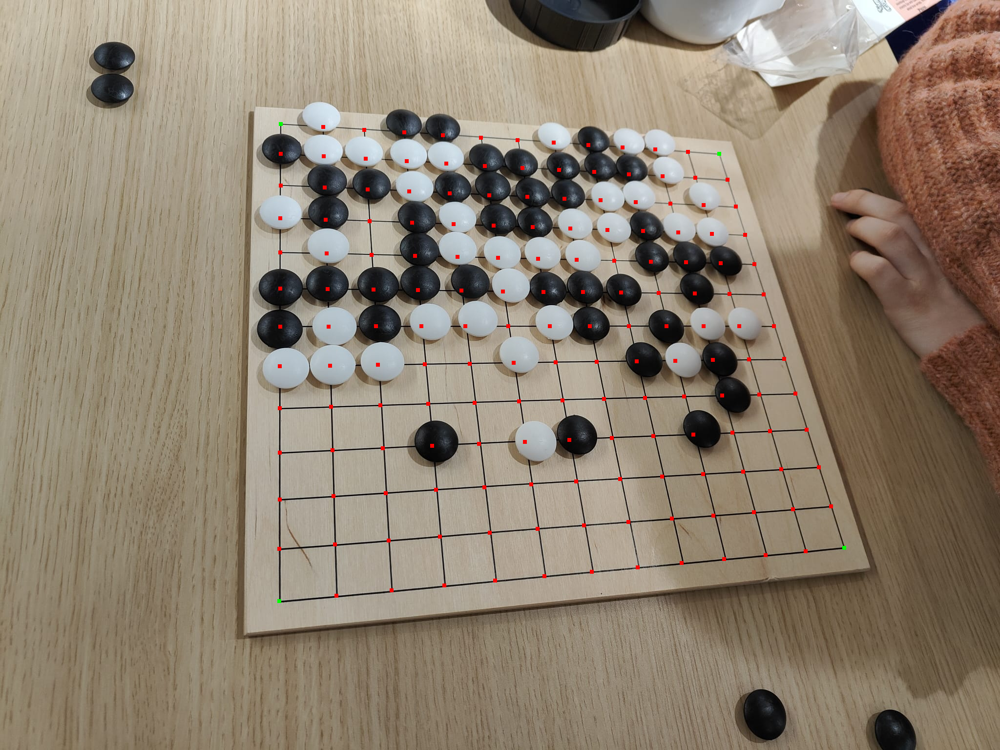

In [6]:
# Example
cols = []
for i in range(13):
    for j in range(13):
        cols.append((i, j, 1))
points = np.array(cols)
corners = [(254, 575), (1231, 572), (315, 1473), (1122, 1729)]

xxx = read_image('im4.jpeg')
for cor in get_all_grid_points(corners, 13):
    rcor = [round(cor[0]), round(cor[1])]
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 0] = 255
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 1] = 0
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 2] = 0
for cor in corners:
    rcor = [round(cor[0]), round(cor[1])]
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 0] = 0
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 1] = 255
    xxx[rcor[0]-4:rcor[0]+4, rcor[1]-4:rcor[1]+4, 2] = 0
preview(xxx)

## Stone identification
We now know the positions of the stones, so we want to try and identify them. We do this by separating pixel space into three different groups - "white", "black" and "other".

Old attempt:
We identify a shape around each intersection as a quadrilateral defined 1/3 of the way from each intersection, weighting the centre pixels more than the outer pixels linearly more, from 1 to 0, and look at the average value therein.

New attempt:
We know that conic sections transform to conic sections under a projective transformation. In particular, we define our circle by $z^T C z = 0$, then the projective transformation that sends $z=(x, y, 1)$ to $w=(u, v, 1)$ clearly sends the circle to some general conic section $w^T (M^{-1})^T C M^{-1} w = 0$. In grid space, we define the circle as being centred on an intersection and having a radius of $r<1$ and so, with centre $(x_0, y_0)$ we get $(x-x_0)^2 + (y-y_0)^2 = r^2$ and so:

$$
C = \begin{bmatrix}
    1 & 0 & -x_0 \\
    0 & 1 & -y_0 \\
    -x_0 & -y_0 & x_0^2 + y_0^2 - r^2 \\
\end{bmatrix}
$$

In [35]:
def get_stone_mask(x0, y0, image_x, image_y, corners, grid_size, r=0.2):
    C_matrix = np.array([
        [1, 0, -x0],
        [0, 1, -y0],
        [-x0, -y0, x0 * x0 + y0 * y0 - r ** 2]
    ])
    M = np.linalg.inv(_get_trans_matrix(corners, grid_size))
    E_matrix = M.T @ C_matrix @ M
    im_X, im_Y = np.ogrid[:image_x, :image_y]
    dist = (
        im_X * im_X       * E_matrix[0, 0] 
        + 2 * im_X * im_Y * E_matrix[0, 1]
        + 2 * im_X * 1    * E_matrix[0, 2]
        + im_Y * im_Y     * E_matrix[1, 1]
        + 2 * im_Y * 1    * E_matrix[1, 2]
        + 1 * 1           * E_matrix[2, 2]
    )
    return (dist * dist) * (dist < 0)

def avg_mask(fimg, mask):
    r = round((mask * fimg[:, :, 0]).sum() / mask.sum())
    g = round((mask * fimg[:, :, 1]).sum() / mask.sum())
    b = round((mask * fimg[:, :, 2]).sum() / mask.sum())
    return np.array([r, g, b])

def naive_identify_stone(px):
    if all(px < 65):
        # Black
        return 0
    if (px[2] - px[0] > -5 and all(px > 150)) or all(px > 210):
        # White
        return 1
    if max(abs(px[2] - px[0]), abs(px[1] - px[0]), abs(px[2] - px[1])) > 30:
        return 2
    if all(px < 80):
        # Black
        return 0
    return 2

def less_naive_identify_stone(px):
    # Use this on the difference of the inner mask and the outer mask
    if all(np.abs(px) < 6):
        return 2
    if all(px > 20):
        return 1
    if all(px < -20):
        return 0
    if np.average(px) > 15:
        return 1
    if np.average(px) < -15:
        return 0
    if np.average(px) > 10:
        return 1
    if np.average(px) < -10:
        return 0
    return 2

def less_naive_identify_stones(image, corners, grid_size):
    float_image = image.astype(float)
    outdict = {}
    for idx in range(grid_size):
        for jdx in range(grid_size):
            mask_inner = get_stone_mask(jdx, idx, image.shape[0], image.shape[1], corners, grid_size, r=0.2)
            mask_outer = get_stone_mask(jdx, idx, image.shape[0], image.shape[1], corners, grid_size, r=0.7)
            avg_val_inner = avg_mask(float_image, mask_inner)
            avg_val_outer = avg_mask(float_image, mask_outer)
            outdict[(idx, jdx)] = less_naive_identify_stone(avg_val_inner - avg_val_outer)
    return outdict


def identify_stones(px):
    float_image = image.astype(float)
    outdict = {}
    for idx in range(grid_size):
        for jdx in range(grid_size):
            mask = get_stone_mask(jdx, idx, image.shape[0], image.shape[1], corners, grid_size)
            avg_val = avg_mask(float_image, mask)
            outdict[(idx, jdx)] = naive_identify_stone(avg_val)
    return outdict

def normalise(dic, grid, size=50):
    img = np.zeros((grid * size, grid * size, 3))
    for x, y in dic:
        avg_val = dic[(x, y)]
        img[size*x:(size)*(x+1), size*y:(size+1)*(y+1)] = avg_val
    return img.astype('uint8')

def get_img_board_state_less_naive(img, corners, grid_size, visualise=False):
    float_image = img.astype(float)
    outdict = {}
    if visualise:
        cloned_image = img.copy()
    for idx in range(grid_size):
        for jdx in range(grid_size):
            mask_inner = get_stone_mask(idx, jdx, img.shape[0], img.shape[1], corners, grid_size, r=0.2)
            mask_outer = get_stone_mask(idx, jdx, img.shape[0], img.shape[1], corners, grid_size, r=0.7)
            avg_val_inner = avg_mask(float_image, mask_inner)
            avg_val_outer = avg_mask(float_image, mask_outer)
            stone_val = less_naive_identify_stone(avg_val_inner - avg_val_outer)
            outdict[(idx, jdx)] = stone_val
            if visualise:
                cloned_image[mask_inner > 0] = avg_val_inner
                if stone_val == 0:
                    cloned_image[mask_inner > 0] = np.array([0, 0, 0])
                elif stone_val == 1:
                    cloned_image[mask_inner > 0] = np.array([255, 255, 255])
                else:
                    cloned_image[mask_inner > 0] = np.array([255, 125, 125])
    if visualise:
        return outdict, preview(cloned_image)
    return outdict

def _get_img_avg_vals(img, corners, grid_size, visualise=False):
    float_image = img.astype(float)
    outdict = {}
    if visualise:
        cloned_image = img.copy()
    for idx in range(grid_size):
        for jdx in range(grid_size):
            mask = get_stone_mask(idx, jdx, img.shape[0], img.shape[1], corners, grid_size)
            avg_val = avg_mask(float_image, mask)
            outdict[(idx, jdx)] = avg_val
            if visualise:
                cloned_image[mask > 0] = avg_val
    if visualise:
        return outdict, preview(cloned_image)
    return outdict

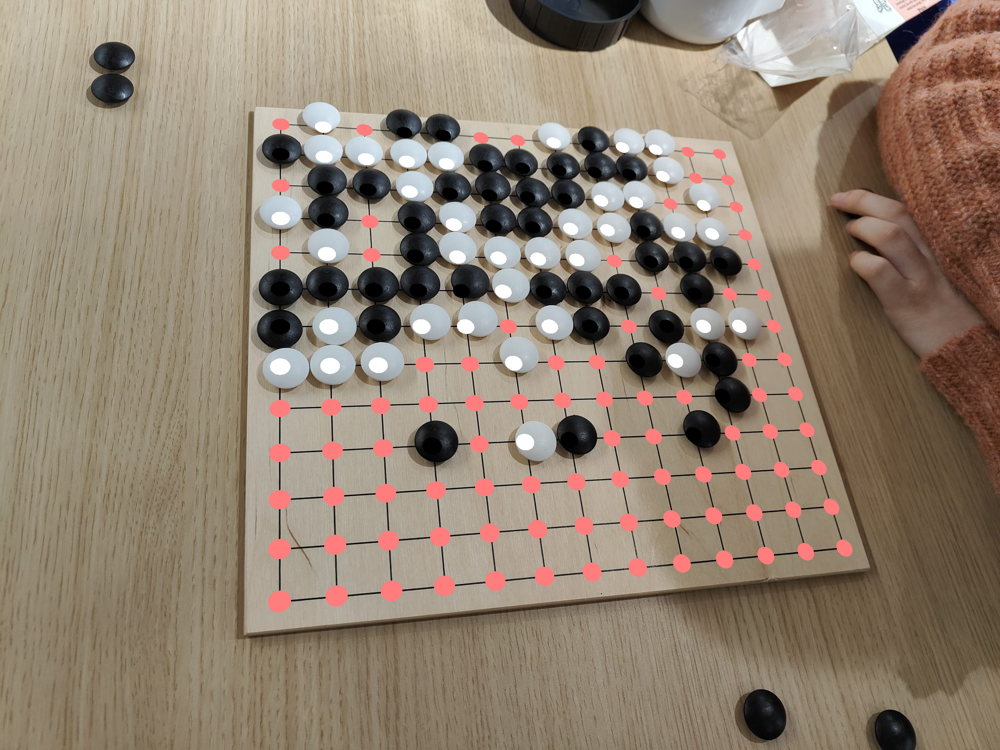

In [11]:
# Example
corners = [(254, 575), (315, 1473), (1231, 572), (1122, 1729)]

xxx4 = read_image('im4.jpeg')
anal4, img = get_img_board_state(xxx4, corners, 13, True)
img

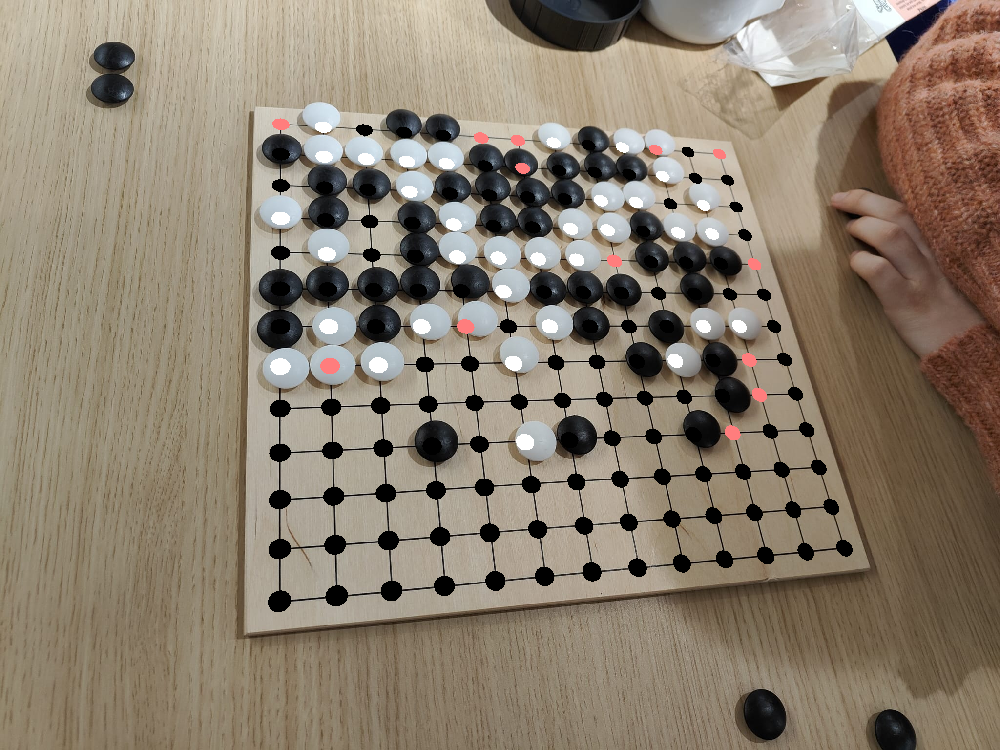

In [36]:
# Example
corners = [(254, 575), (315, 1473), (1231, 572), (1122, 1729)]

xxx4 = read_image('im4.jpeg')
anal4, img = get_img_board_state_less_naive(xxx4, corners, 13, True)
img

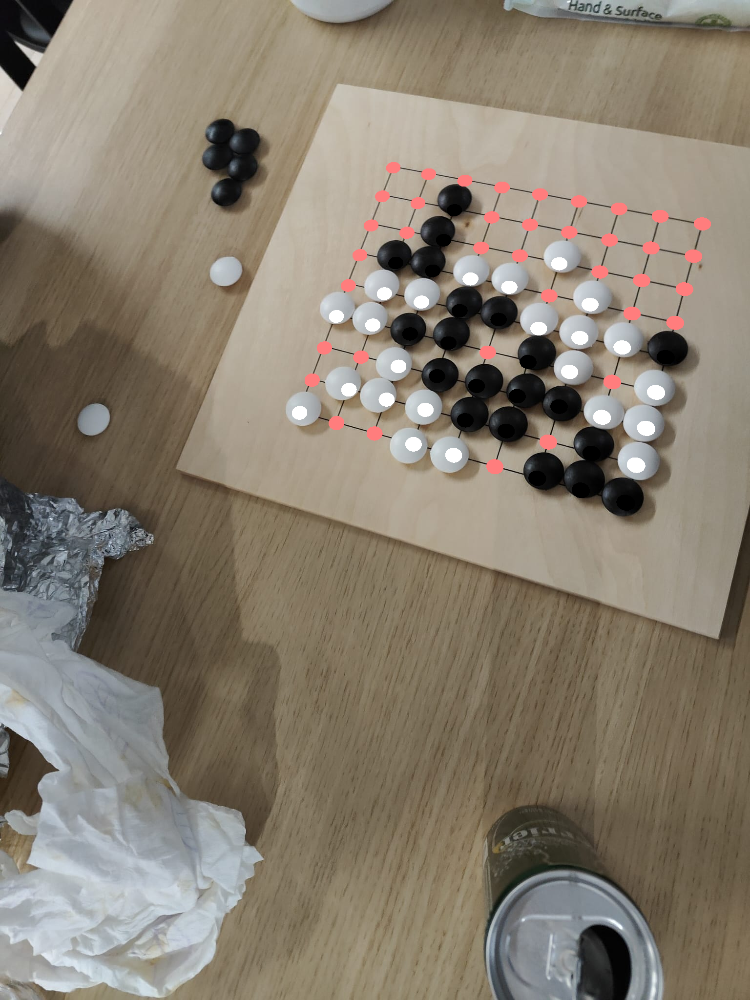

In [199]:
corners = [(343, 805), (458, 1438), (845, 613), (1029, 1281)]
xxx3 = read_image('im3.jpeg')
anal3, img = get_img_board_state(xxx3, corners, 9, True)
img

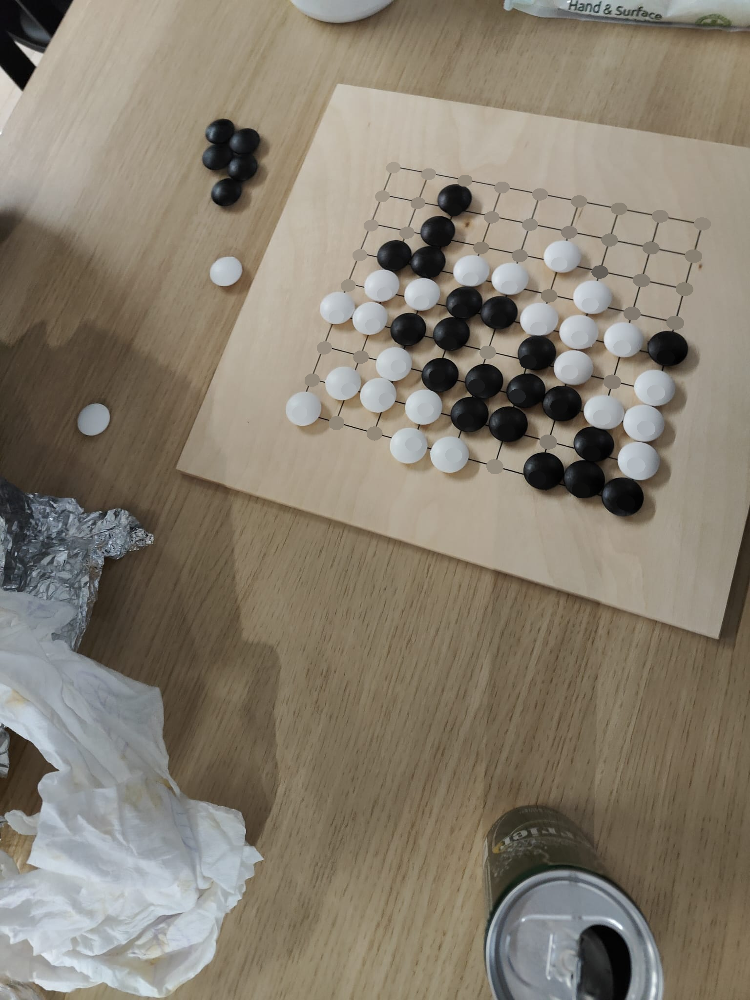

In [216]:
corners = [(343, 805), (458, 1438), (845, 613), (1029, 1281)]
xxx3 = read_image('im3.jpeg')
_, img = _get_img_avg_vals(xxx3, corners, 9, True)
img

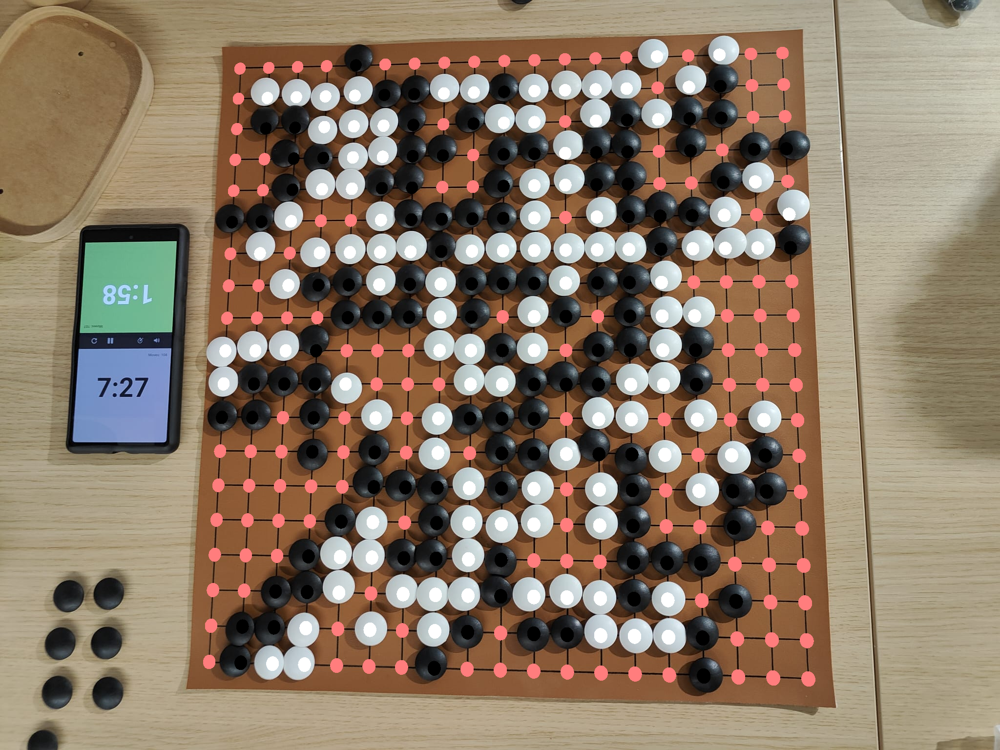

In [201]:
corners = [(140, 491), (108, 1602), (1355, 428), (1390, 1655)]
xxx6 = read_image('im6.jpeg')
anal6, img = get_img_board_state(xxx6, corners, 19, True)
img

## Create Katago Analysis File

Now we turn the board state into a file for analysis.

In [126]:
def create_katago_dict(board_state, grid_size, initial_player='B'):
    outdict = {}
    initialStones = []
    for xidx, yidx in board_state:
        player = board_state[(xidx, yidx)]
        if player == 0:
            initialStones.append(['B', f"({xidx},{grid_size - yidx - 1})"])
        elif player == 1:
            initialStones.append(['W', f"({xidx},{grid_size - yidx - 1})"])
    outdict['id'] = 'foo'
    outdict['initialStones'] = initialStones
    outdict['moves'] = []
    outdict["rules"] = "tromp-taylor"
    outdict["komi"] = 6.5
    outdict["boardXSize"] = grid_size
    outdict["boardYSize"] = grid_size
    outdict["initialPlayer"] = initial_player
    return outdict

def dict_to_json(katago_dict):
    return json.dumps(katago_dict, separators=(',', ':'))

def dict_to_json_on_disk(katago_dict, fpath):
    json.dump(katago_dict, open(fpath, 'w'), separators=(',', ':'))

def call_katago(katago_dict):
    katago_json = dict_to_json(katago_dict)
    cwd = [
        'katagoopencl\\katago.exe', 'analysis',
        '-config', 'katagoopencl/default_gtp.cfg',
        '-model', 'nets/g170-b30c320x2-s4824661760-d1229536699.bin.gz'
    ]
    process = sp.Popen(cwd, stdin=sp.PIPE, stdout=sp.PIPE)
    data = process.communicate(bytes(katago_json + '\r\n', 'utf8'))
    process.kill()
    if data[1] is None:
        return json.loads(data[0])
    raise Exception(f"Something failed. Request info:\nINPUT:\n{cwd}\n{katago_json}\n\nOUTPUT\n{data}")

In [397]:
call_katago(create_katago_dict(anal6, 19))

{'id': 'foo',
 'isDuringSearch': False,
 'moveInfos': [{'lcb': -0.00268572375,
   'move': 'P16',
   'order': 0,
   'prior': 0.129024431,
   'pv': ['P16', 'G9', 'P18', 'Q19'],
   'scoreLead': -135.17001,
   'scoreMean': -135.17001,
   'scoreSelfplay': -135.114244,
   'scoreStdev': 7.17122021,
   'utility': -1.21433831,
   'utilityLcb': -1.22206734,
   'visits': 53,
   'winrate': 7.4642064e-05},
  {'lcb': -0.0102227654,
   'move': 'G9',
   'order': 1,
   'prior': 0.0949742049,
   'pv': ['G9', 'G8', 'H9', 'K11', 'F9', 'J7', 'P16'],
   'scoreLead': -137.884742,
   'scoreMean': -137.884742,
   'scoreSelfplay': -137.038617,
   'scoreStdev': 13.0159661,
   'utility': -1.21912749,
   'utilityLcb': -1.24801584,
   'visits': 45,
   'winrate': 9.45018562e-05},
  {'lcb': -0.00368430965,
   'move': 'S19',
   'order': 2,
   'prior': 0.0770816356,
   'pv': ['S19', 'G10', 'T8', 'T9'],
   'scoreLead': -135.851153,
   'scoreMean': -135.851153,
   'scoreSelfplay': -135.692186,
   'scoreStdev': 8.06501238

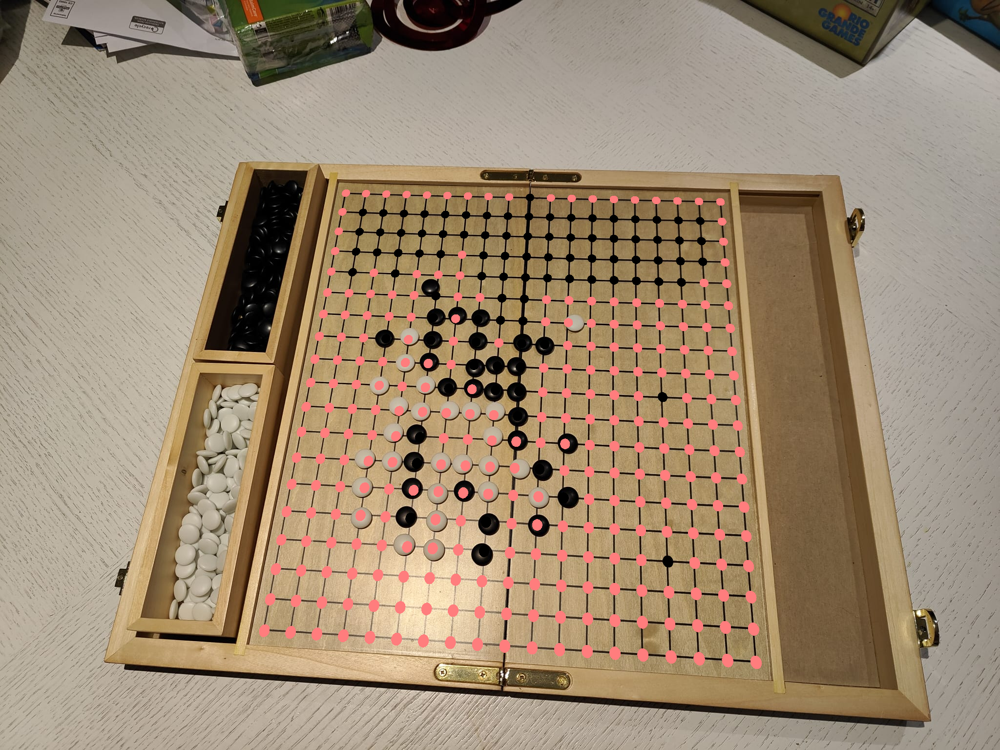

In [37]:
# Example
gsize = 19
corners = [(395, 708), (1291, 541), (413, 1475), (1356, 1548)]

xxx19 = read_image('im19.jpeg')
anal19, img = get_img_board_state(xxx19, corners, 19, True)
img

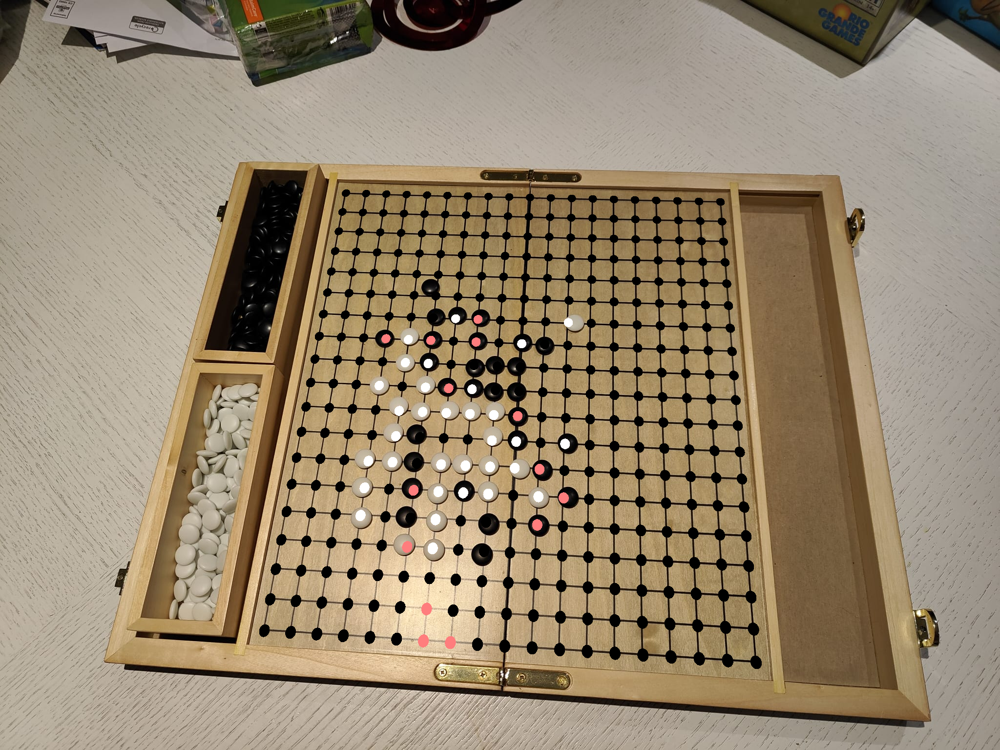

In [38]:
# Example
gsize = 19
corners = [(395, 708), (1291, 541), (413, 1475), (1356, 1548)]

xxx19 = read_image('im19.jpeg')
anal19, img = get_img_board_state_less_naive(xxx19, corners, 19, True)
img

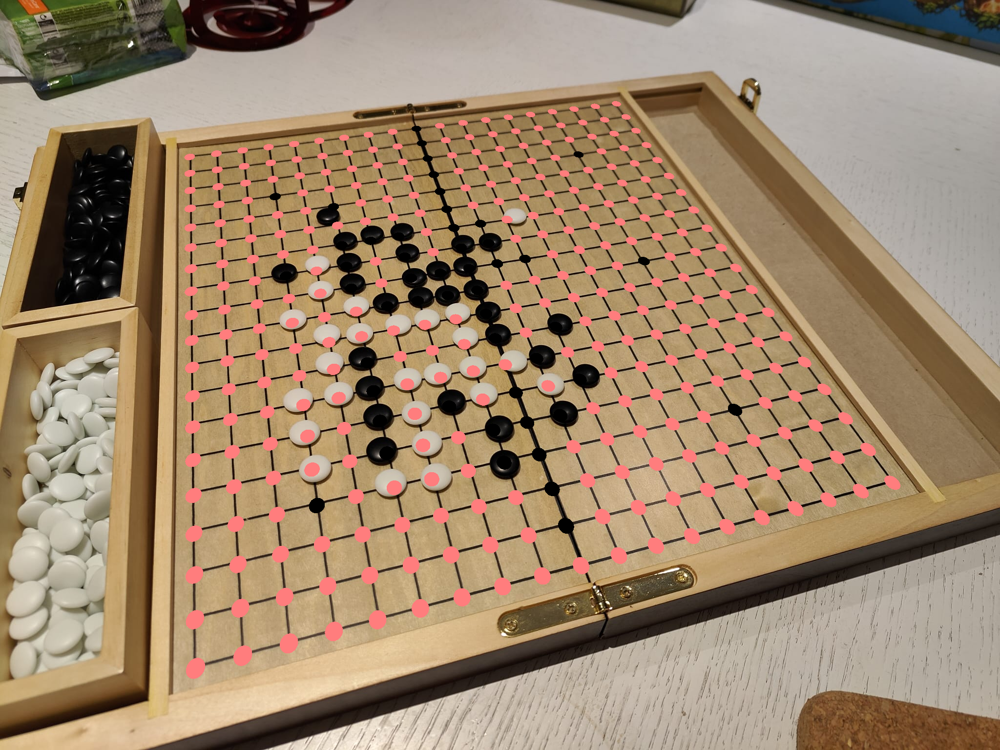

In [235]:
# Example
gsize = 19
corners = [(321, 388), (1368, 400), (212, 1262), (988, 1827)]

xxx18 = read_image('im18.jpeg')
anal18, img = get_img_board_state(xxx18, corners, 19, True)
img

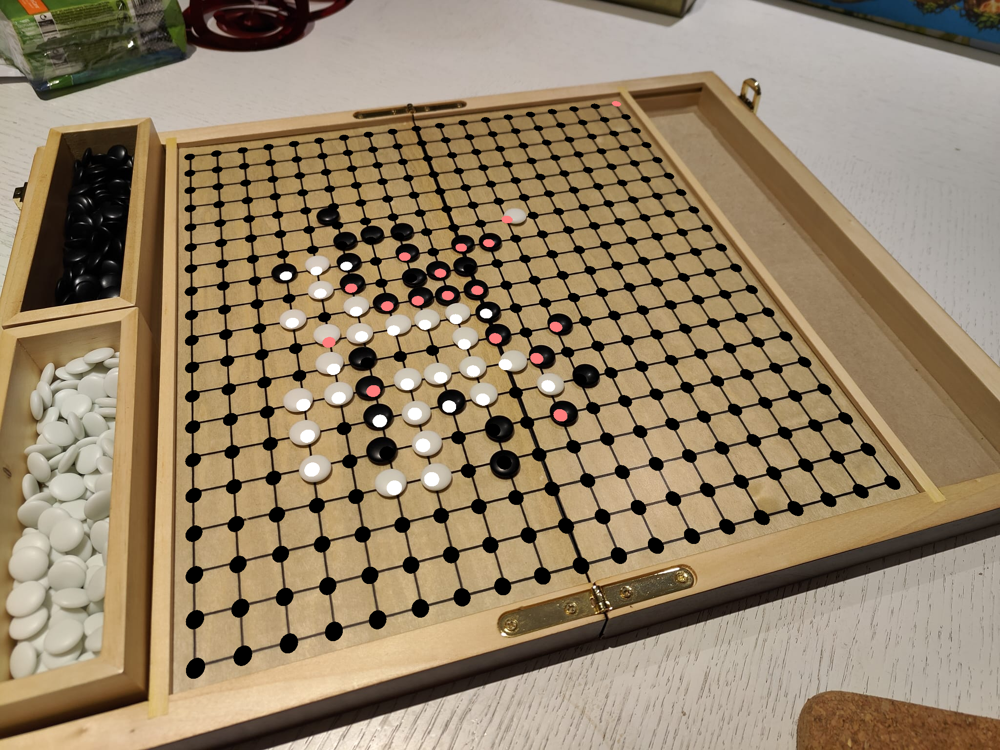

In [39]:
# Example
gsize = 19
corners = [(321, 388), (1368, 400), (212, 1262), (988, 1827)]

xxx18 = read_image('im18.jpeg')
anal18, img = get_img_board_state_less_naive(xxx18, corners, 19, True)
img

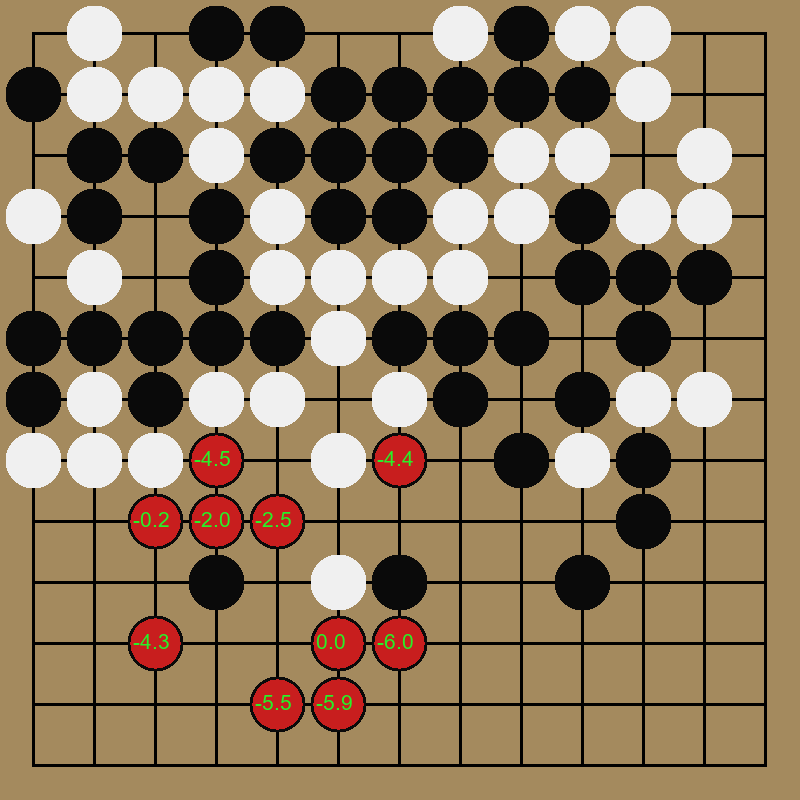

In [233]:
from PIL import Image

def _grid_to_posn(gridpos: str):
    # Go boards don't use I for some reason...
    x_coord = ord(gridpos[0]) - 65
    if x_coord > 7:
        x_coord -= 1
    y_coord = int(gridpos[1:]) - 1
    return (x_coord, y_coord)
    

def identify_moves(katago_outdict, topn=10):
    outdict = {}

    player = katago_outdict['rootInfo']['currentPlayer']
    moves = katago_outdict['moveInfos']
    bestmove_score = moves[0]['scoreMean'] 
    for n in range(min(topn, len(moves))):
        move = moves[n]
        posn = _grid_to_posn(move['move'])
#         utility = move['utility']
        score_mean = move['scoreMean'] - bestmove_score
        score_std = move['scoreStdev']
#         winrate = move['winrate']
        outdict[posn] = (score_mean, score_std)
    return player, outdict

def show_grid(board_state, grid_size, analysis=None):
    imgsize = 800
    line_thickness = 3
    inner_gridsize = (imgsize // grid_size) - line_thickness
    border = (imgsize - line_thickness - (grid_size - 1) * (imgsize // grid_size)) // 2
    stone_radius = ((inner_gridsize - 1) // 2)

    img = Image.new("RGB", (imgsize, imgsize), color=(164, 138, 94))
    pixels = img.load()

    top = border
    bottom = border + (line_thickness + inner_gridsize) * (grid_size - 1) + line_thickness
    for line in range(grid_size):
        boundary1 = border + (line_thickness + inner_gridsize) * line
        boundary2 = border + (line_thickness + inner_gridsize) * line + line_thickness
        for x in range(boundary1, boundary2):
            for y in range(top, bottom):
                pixels[x,y] = (0,0,0)
                pixels[y,x] = (0,0,0)
    
    if analysis is not None:
        player, analysis_out = identify_moves(analysis)
        font = ImageFont.truetype("arial.ttf", 1 + int(imgsize / grid_size / 3), encoding="unic")
        d = ImageDraw.Draw(img)
    else:
        analysis_out = dict()
    
    for x in range(grid_size):
        for y in range(grid_size):
            centre_x = border + (line_thickness + inner_gridsize) * x + (line_thickness // 2)
            centre_y = border + (line_thickness + inner_gridsize) * y + (line_thickness // 2)
            for pixel_x in range(centre_x - stone_radius, centre_x + stone_radius + 1):
                for pixel_y in range(centre_y - stone_radius, centre_y + stone_radius + 1):
                    if (pixel_x - centre_x) ** 2 + (pixel_y - centre_y) ** 2 < stone_radius ** 2:
                        if board_state[(x, y)] == 0:
                            pixels[pixel_x, pixel_y] = (10, 10, 10)
                        elif board_state[(x, y)] == 1:
                            pixels[pixel_x, pixel_y] = (240, 240, 240)
                        elif (x, y) in analysis_out:
                            if (pixel_x - centre_x) ** 2 + (pixel_y - centre_y) ** 2 >= 0.8 * stone_radius ** 2:
                                if player == 'B':
                                    pixels[pixel_x, pixel_y] = (10, 10, 10)
                                else:
                                    pixels[pixel_x, pixel_y] = (240, 240, 240)
                            else:
                                pixels[pixel_x, pixel_y] = (200, 30, 30)
            if (x, y) in analysis_out:
                score, score_std = analysis_out[(x, y)]
                d.text((centre_x - stone_radius * 4 // 5, centre_y - stone_radius//2),
                       f"{score:.1f}", font=font, fill=(40, 240, 40, 128))
    return img

analysis4 = call_katago(create_katago_dict(anal4, 13))
show_grid(anal4, 13, analysis4)

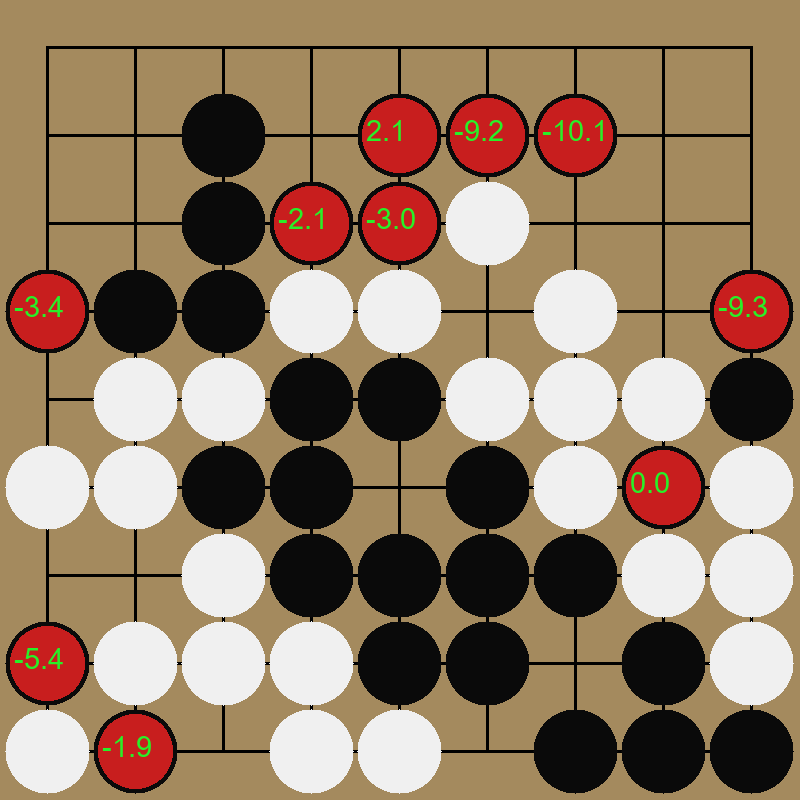

In [226]:
analysis3 = call_katago(create_katago_dict(anal3, 9))
show_grid(anal3, 9, analysis3)

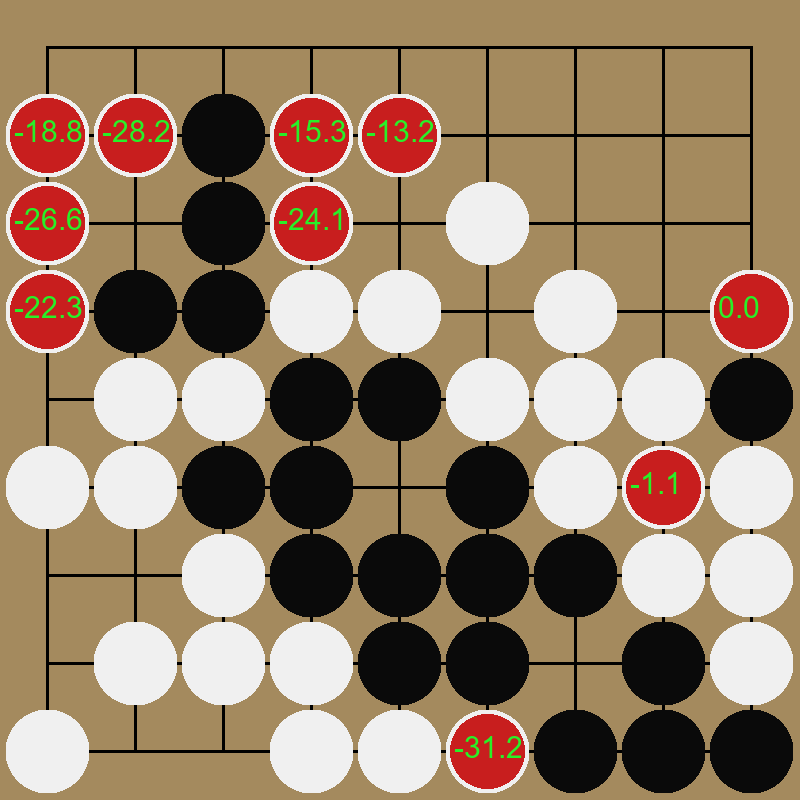

In [232]:
analysis3 = call_katago(create_katago_dict(anal3, 9, 'W'))
show_grid(anal3, 9, analysis3)

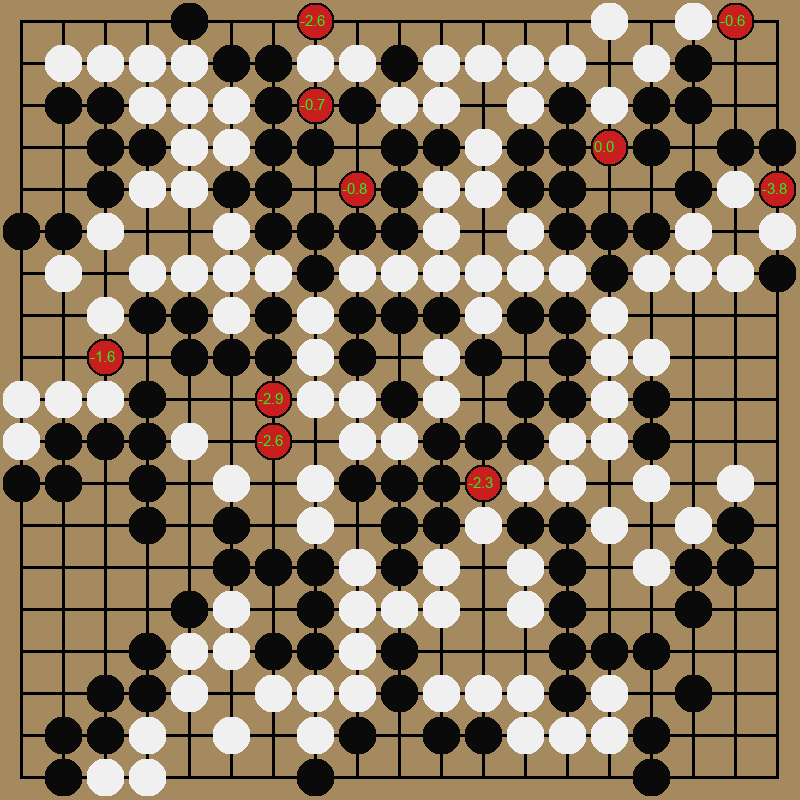

In [231]:
analysis6 = call_katago(create_katago_dict(anal6, 19))
show_grid(anal6, 19, analysis6)